## Training and evaluation of different models

#### Import libraries and external functions

Only for notebooks

In [1]:
%load_ext autoreload
%autoreload 2

In [17]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import time
import os
import healpy as hp
import random
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm, colors


import torch
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader

from modules.utils import init_device
from modules.healpix_models import UNetSphericalHealpix, UNetSphericalTempHealpix, Conv1dAuto, \
UNetSphericalHealpixResidual, _compute_laplacian_healpix, ConvBlock, ConvCheb, UNetSphericalHealpixResidual_2
from modules.test import compute_rmse_healpix
from modules.plotting import plot_rmses
from modules.full_pipeline import load_data_split, WeatherBenchDatasetXarrayHealpixTemp, \
                                  train_model_2steps, create_iterative_predictions_healpix_temp, \
                                  compute_errors, plot_climatology
from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps, plot_benchmark_simple
from modules.data import hp_to_equiangular


import warnings
warnings.filterwarnings("ignore")

Define paths and create directories if required

In [3]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
prediction_path = '../data/healpix/predictions/'

if not os.path.isdir(model_save_path):
    os.mkdir(model_save_path)
    
if not os.path.isdir(pred_save_path):
    os.mkdir(pred_save_path)

Define constants and load data

In [4]:
chunk_size = 521

train_years = ('1990', '2012')#('1979', '2012')
val_years = ('2013', '2016')
test_years = ('2017', '2018')

nodes = 12*16*16
max_lead_time = 5*24
nb_timesteps = 2

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="2"
gpu = [0]
num_workers = 10
pin_memory = True

nb_epochs = 20
learning_rate = 8e-3

obs = xr.open_mfdataset(pred_save_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
rmses_weyn = xr.open_dataset(datadir + 'metrics/rmses_weyn.nc')

#### Data

Load data, define dynamic dataset and separate into train, validation and test

In [5]:
ds_train, ds_valid, ds_test = load_data_split(input_dir, train_years, val_years, test_years, chunk_size)

In [6]:
constants = xr.open_dataset(f'{input_dir}constants/constants_5.625deg_standardized.nc')

orog = constants['orog']
lsm = constants['lsm']
lats = constants['lat2d']
slt = constants['slt']

num_constants = len([orog, lats, lsm, slt])

train_mean_ = xr.open_mfdataset(f'{input_dir}mean_train_features_dynamic.nc')
train_std_ = xr.open_mfdataset(f'{input_dir}std_train_features_dynamic.nc')

Define model parameters

In [7]:
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

In [8]:
architecture_name = "loss_five_steps_progressive"
description = "all_const_len{}_delta_{}_architecture_".format(len_sqce, delta_t) + architecture_name

model_filename = model_save_path + description + ".h5"
pred_filename = pred_save_path +  description + ".nc"
rmse_filename = datadir + 'metrics/rmse_' + description + '.nc'

Generate dataloader

In [9]:
class WeatherBenchDatasetXarrayHealpixTempMultiple(Dataset):
    
    """ Dataset used for graph models (1D), where data is loaded from stored numpy arrays.
    
    Parameters
    ----------
    ds : xarray Dataset
        Dataset containing the input data
    out_features : int
        Number of output features
    delta_t : int
        Temporal spacing between samples in temporal sequence (in hours)
    len_sqce : int
        Length of the input and output (predicted) sequences
    years : tuple(str)
        Years used to split the data
    nodes : float
        Number of nodes each sample has
    max_lead_time : int
        Maximum lead time (in case of iterative predictions) in hours
    load : bool
        If true, load dataset to RAM
    mean : np.ndarray of shape 2
        Mean to use for data normalization. If None, mean is computed from data
    std : np.ndarray of shape 2
        std to use for data normalization. If None, mean is computed from data
    """
        
    def __init__(self, ds, out_features, delta_t, len_sqce_input, len_sqce_output, years, nodes, nb_timesteps, 
                 max_lead_time=None, load=True, mean=None, std=None, requires_st=None):
        
        
        self.delta_t = delta_t
        self.len_sqce = len_sqce_input
        self.len_output = len_sqce_output
        self.years = years
        
        self.nodes = nodes
        self.out_features = out_features
        self.max_lead_time = max_lead_time
        self.nb_timesteps = nb_timesteps
        
        self.data = ds.to_array(dim='level', name='Dataset').transpose('time', 'node', 'level')
        self.in_features = self.data.shape[-1]
        
        self.mean = self.data.mean(('time', 'node')).compute() if mean is None else mean
        self.std = self.data.std(('time', 'node')).compute() if std is None else std
        
        eps = 0.001 #add to std to avoid division by 0
        
        # Count total number of samples
        total_samples = self.data.shape[0]        
        
        if max_lead_time is None:
            self.n_samples = total_samples - (len_sqce_output+1) * delta_t
        else:
            self.n_samples = total_samples - (len_sqce_output+1) * delta_t - max_lead_time
        
        # Normalize

        if requires_st:
            self.data = self.data.groupby('time.month') - self.mean.to_array(dim='level')
            self.data = self.data.groupby('time.month') / self.std.to_array(dim='level')
            self.data.compute()
        else:
            self.data = (self.data - self.mean.to_array(dim='level')) / (
                        self.std.to_array(dim='level') + eps)
        self.data.persist()
        
        self.idxs = np.array(range(self.n_samples))
        
        print('Loading data to RAM...')
        t = time.time()
        self.data.load()
        print('Time: {:.2f}s'.format(time.time() - t))
        
        
    def __len__(self):
        return self.n_samples
    
    def __getitem__(self, idx):
        """ Returns sample and label corresponding to an index as torch.Tensor objects
            The return tensor shapes are (for the sample and the label): [n_vertex, len_sqce, n_features]
            
        """
        idx_data = idx#self.idxs[idx]
        #1,0,2
        
        #batch[0] --> (batch_size, num_nodes, n_features*len_sq)
        #print(np.array([[idx_data + self.delta_t*k] for k in range(self.len_sqce + self.len_output)]).reshape(-1))
        idx_full = np.concatenate(np.array([[idx_data + self.delta_t*k] for k in range(self.len_sqce + self.len_output)])).reshape(-1)
        #idx_full = np.concatenate(np.array([[idx_data+self.delta_t*k] for k in range(self.len_sqce+2)]).reshape(-1,1)) # ex: len_sqce=2 --> we need 0,1,2,3
        #idx_full = np.concatenate([idx_data+delta_t,  idx_data + delta_t * len_sqce, idx_data + delta_t * (len_sqce+1)])
        dat = self.data.isel(time=idx_full).values
        
        
        X = (
            torch.tensor(dat[:len(idx)*self.len_sqce,:,:] , \
                         dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1),
        )
        
        y = [
            
            torch.tensor(dat[len(idx)*(self.len_sqce + k -1 ):len(idx)*(self.len_sqce + k +1), :, :], \
                         dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1)
            for k in range(self.len_output)
        ]
        
        #y = (torch.tensor(dat[len(idx):len(idx)*(self.len_sqce+1),:,:],\
        #                 dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1),\
        #     torch.tensor(dat[len(idx)*(self.len_sqce):,:,:self.out_features],\
        #                 dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1)
        #)
        return X, y

In [10]:
training_ds = WeatherBenchDatasetXarrayHealpixTempMultiple(ds=ds_train, out_features=out_features, delta_t=delta_t,
                                                   len_sqce_input=len_sqce, len_sqce_output=5, max_lead_time=max_lead_time,
                                                   years=train_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                   mean=train_mean_, std=train_std_)

validation_ds = WeatherBenchDatasetXarrayHealpixTempMultiple(ds=ds_valid, out_features=out_features, delta_t=delta_t,
                                                     len_sqce_input=len_sqce, len_sqce_output=5, max_lead_time=max_lead_time,
                                                     years=val_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                     mean=train_mean_, std=train_std_)

Loading data to RAM...
Time: 30.41s
Loading data to RAM...
Time: 5.09s


#### Model

Define model, train and evaluate train and validation losses



In [11]:
spherical_unet = UNetSphericalHealpix(N=nodes, in_channels=in_features*len_sqce, out_channels=out_features, kernel_size=3)
spherical_unet, device = init_device(spherical_unet, gpu=gpu)


In [12]:
batch_size = 20
epochs=5

In [13]:
constants_tensor = torch.tensor(xr.merge([orog, lats, lsm, slt], compat='override').to_array().values, \
                            dtype=torch.float)

# standardize 
constants_tensor = (constants_tensor - torch.mean(constants_tensor, dim=1).view(-1,1).expand(4, 3072)) / \
                    torch.std(constants_tensor, dim=1).view(-1,1).expand(4, 3072)

In [20]:
def update_w(w):
    for i in range(1,5):
        if (w[5 - i] + 1e-3) <  w[5 - i -1]:
            w[5 - i] += w[5 - i -1]*0.1
    w = np.array(w)/sum(w)
    return w

In [14]:
def train_model_multiple_steps(model, device, training_ds, len_output, constants, batch_size, epochs, lr, validation_ds):
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, eps=1e-7, weight_decay=0, amsgrad=False)

    train_losses = []
    val_losses = []
    n_samples = training_ds.n_samples
    n_samples_val = validation_ds.n_samples
    num_nodes = training_ds.nodes
    num_constants = constants.shape[1]
    out_features = training_ds.out_features
    num_in_features = training_ds.in_features + num_constants

    constants_expanded = constants.expand(batch_size, num_nodes, num_constants)
    constants1 = constants_expanded.to(device)
    idxs_val = validation_ds.idxs
    
    #initially give full weight to first output
    weights_loss = [1] + [0]*(len_output - 1)
    weight_variations = [(weights_loss, 0, 0)]

    for epoch in range(epochs):

        print('\rEpoch : {}'.format(epoch), end="")

        time1 = time.time()

        val_loss = 0
        train_loss = 0

        model.train()

        random.shuffle(training_ds.idxs)
        idxs = training_ds.idxs

        batch_idx = 0
        train_loss_it = []
        times_it = []
        t0 = time.time()
        for i in range(0, n_samples - batch_size, batch_size):
            i_next = min(i + batch_size, n_samples)

            if len(idxs[i:i_next]) < batch_size:
                constants_expanded = constants.expand(len(idxs[i:i_next]), num_nodes, num_constants)
                constants1 = constants_expanded.to(device)

            batch, labels = training_ds[idxs[i:i_next]]

            # Transfer to GPU
            batch_size = batch[0].shape[0] // 2
            
            batch1 = torch.cat((batch[0][:batch_size, :, :], \
                                constants_expanded, batch[0][batch_size:, :, :], constants_expanded), dim=2).to(device)
            
            # generate predictions multiple steps ahead sequentially
            output = model(batch1)
            label1 = labels[0].to(device)
            loss_ahead = weights_loss[0] * criterion(output, label1[batch_size:, :, :out_features])
            
            for step_ahead in range(1, len_output):
                # input t-2
                inp_t2 = batch1[:, :, num_in_features:]
                
                # toa at t-1
                toa_delta = labels[step_ahead][:batch_size, :, -1].view(-1, num_nodes, 1).to(device)
                batch1 = torch.cat((inp_t2, output, toa_delta, constants1), dim=2)
                
                output = model(batch1)
                label1 = labels[step_ahead].to(device)
                loss_ahead += weights_loss[step_ahead] * criterion(output, label1[batch_size:, :, :out_features])
                
            
            optimizer.zero_grad()
            loss_ahead.backward()
            optimizer.step()

            train_loss += loss_ahead.item() * batch_size
            train_loss_it.append(train_loss / (batch_size * (batch_idx + 1)))
            if len(train_loss_it) > 5:
                if (np.std(train_loss_it[-10:]) < 1e-5) and count_upd > 1e4:
                    weights_loss = update_w(weights_loss)
                    count_upd = 0
                    print('New weights ', weights_loss, ' Epoch {} Iter {}'.format(epoch, i))
                    weight_variations.append((weights_loss, epoch, i))
                else:
                    count_upd += 1
                    
            times_it.append(time.time() - t0)
            t0 = time.time()

            if batch_idx % 50 == 0:
                print('\rBatch idx: {}; Loss: {:.3f} - Other {}'\
                      .format(batch_idx, train_loss / (batch_size * (batch_idx + 1)), np.std(train_loss_it[-5:])),
                      end="")
            batch_idx += 1

        train_loss = train_loss / n_samples
        train_losses.append(train_loss)

        model.eval()

        constants1 = constants_expanded.to(device)
        with torch.set_grad_enabled(False):
            index = 0

            for i in range(0, n_samples_val - batch_size, batch_size):
                i_next = min(i + batch_size, n_samples_val)

                if len(idxs_val[i:i_next]) < batch_size:
                    constants_expanded = constants.expand(len(idxs_val[i:i_next]), num_nodes, num_constants)
                    constants1 = constants_expanded.to(device)

                batch, labels = training_ds[idxs[i:i_next]]

                # Transfer to GPU
                batch_size = batch[0].shape[0] // 2
                batch1 = torch.cat((batch[0][:batch_size, :, :], \
                                    constants_expanded, batch[0][batch_size:, :, :], constants_expanded), dim=2).to(device)

                # generate predictions multiple steps ahead sequentially
                output = model(batch1)
                label1 = labels[0].to(device)
                loss_ahead = weights_loss[0] * criterion(output, label1[batch_size:, :, :out_features]).item()

                for step_ahead in range(1, len_output):
                    # input t-2
                    inp_t2 = batch1[:, :, num_in_features:]

                    # toa at t-1
                    toa_delta = labels[step_ahead][:batch_size, :, -1].view(-1, num_nodes, 1).to(device)
                    batch1 = torch.cat((inp_t2, output, toa_delta, constants1), dim=2)

                    output = model(batch1)
                    label1 = labels[step_ahead].to(device)
                    loss_ahead += weights_loss[step_ahead] * criterion(output, label1[batch_size:, :, :out_features]).item()

                val_loss +=  loss_ahead * batch_size
                index = index + batch_size

        val_loss = val_loss / n_samples_val
        val_losses.append(val_loss)

        time2 = time.time()

        # Print stuff
        print('Epoch: {e:3d}/{n_e:3d}  - loss: {l:.3f}  - val_loss: {v_l:.5f}  - time: {t:2f}'
              .format(e=epoch + 1, n_e=epochs, l=train_loss, v_l=val_loss, t=time2 - time1))

    return train_losses, val_losses, train_loss_it, times_it

In [15]:
# Train model
train_loss, val_loss = train_model_multiple_steps(spherical_unet, device, training_ds, 5, constants_tensor.transpose(1,0), \
                                          batch_size=batch_size, epochs=epochs, \
                                           lr=learning_rate, validation_ds=validation_ds)


Batch idx: 2100; Loss: 0.058 - Other 1.989152465643451e-055New weights  [0.625 0.375 0.    0.    0.   ]  Epoch 0 Iter 42820
New weights  [0.390625 0.46875  0.140625 0.       0.      ]  Epoch 0 Iter 42840
New weights  [0.24414063 0.43945313 0.26367188 0.05273437 0.        ]  Epoch 0 Iter 42860
Batch idx: 2500; Loss: 0.073 - Other 1.5655746046083345e-05New weights  [0.15258789 0.36621094 0.32958984 0.13183594 0.01977539]  Epoch 0 Iter 50380
Batch idx: 2600; Loss: 0.074 - Other 1.3425313361087413e-05New weights  [0.09489827 0.28469481 0.34163377 0.20498026 0.07379289]  Epoch 0 Iter 52500
Batch idx: 2750; Loss: 0.076 - Other 1.454812513850323e-055New weights  [0.05823705 0.20965337 0.31448006 0.25158405 0.16604547]  Epoch 0 Iter 55260
Batch idx: 3050; Loss: 0.080 - Other 1.1752551845254508e-05New weights  [0.03494744 0.14677924 0.26420264 0.26420264 0.28986804]  Epoch 0 Iter 61300
Batch idx: 3200; Loss: 0.081 - Other 1.3069020225401626e-05New weights  [0.02036627 0.09775808 0.20529197 0.24

New weights  [6.53574805e-21 2.74501418e-19 5.68217935e-18 7.72776392e-17
 1.00000000e+00]  Epoch 0 Iter 85600
New weights  [3.26787402e-21 1.39211433e-19 2.92344010e-18 4.03434734e-17
 1.00000000e+00]  Epoch 0 Iter 85620
New weights  [1.63393701e-21 7.05860789e-20 1.50348348e-18 2.10487687e-17
 1.00000000e+00]  Epoch 0 Iter 85640
New weights  [8.16968506e-22 3.57832206e-20 7.72917564e-19 1.09754294e-17
 1.00000000e+00]  Epoch 0 Iter 85660
New weights  [4.08484253e-22 1.81367008e-20 3.97193748e-19 5.71958998e-18
 1.00000000e+00]  Epoch 0 Iter 85680
New weights  [2.04242127e-22 9.19089570e-21 2.04037884e-19 2.97895311e-18
 1.00000000e+00]  Epoch 0 Iter 85700
New weights  [1.02121063e-22 4.65672049e-21 1.04776211e-19 1.55068792e-18
 1.00000000e+00]  Epoch 0 Iter 85740
New weights  [5.10605316e-23 2.35899656e-21 5.37851216e-20 8.06776824e-19
 1.00000000e+00]  Epoch 0 Iter 85760
New weights  [2.55302658e-23 1.19481644e-21 2.76002598e-20 4.19523949e-19
 1.00000000e+00]  Epoch 0 Iter 85780
N

New weights  [6.91999242e-43 5.93735349e-41 2.52931259e-39 7.13266150e-38
 1.00000000e+00]  Epoch 0 Iter 87820
New weights  [3.45999621e-43 2.98943672e-41 1.28246835e-39 3.64221013e-38
 1.00000000e+00]  Epoch 0 Iter 87840
New weights  [1.72999810e-43 1.50509835e-41 6.50202487e-40 1.85957911e-38
 1.00000000e+00]  Epoch 0 Iter 87860
New weights  [8.64999052e-44 7.57739170e-42 3.29616539e-40 9.49295632e-39
 1.00000000e+00]  Epoch 0 Iter 87880
New weights  [4.32499526e-44 3.81464582e-42 1.67081487e-40 4.84536312e-39
 1.00000000e+00]  Epoch 0 Iter 87900
New weights  [2.16249763e-44 1.92029790e-42 8.46851372e-41 2.47280601e-39
 1.00000000e+00]  Epoch 0 Iter 87920
New weights  [1.08124882e-44 9.66636441e-43 4.29186580e-41 1.26180854e-39
 1.00000000e+00]  Epoch 0 Iter 87940
New weights  [5.40624408e-45 4.86561967e-43 2.17493199e-41 6.43779869e-40
 1.00000000e+00]  Epoch 0 Iter 87960
New weights  [2.70312204e-45 2.44902857e-43 1.10206285e-41 3.28414731e-40
 1.00000000e+00]  Epoch 0 Iter 87980
N

New weights  [7.32682696e-65 9.49556775e-63 6.12464120e-61 2.62134643e-59
 1.00000000e+00]  Epoch 0 Iter 89560
New weights  [3.66341348e-65 4.76976435e-63 3.09080730e-61 1.32904714e-59
 1.00000000e+00]  Epoch 0 Iter 89580
New weights  [1.83170674e-65 2.39587242e-63 1.55971294e-61 6.73795992e-60
 1.00000000e+00]  Epoch 0 Iter 89600
New weights  [9.15853371e-66 1.20343133e-63 7.87044089e-62 3.41577135e-60
 1.00000000e+00]  Epoch 0 Iter 89620
New weights  [4.57926685e-66 6.04463225e-64 3.97132339e-62 1.73149700e-60
 1.00000000e+00]  Epoch 0 Iter 89640
New weights  [2.28963343e-66 3.03605392e-64 2.00379559e-62 8.77662468e-61
 1.00000000e+00]  Epoch 0 Iter 89660
New weights  [1.14481671e-66 1.52489586e-64 1.01100596e-62 4.44842621e-61
 1.00000000e+00]  Epoch 0 Iter 89680
New weights  [5.72408357e-67 7.65882381e-65 5.10077666e-63 2.25454328e-61
 1.00000000e+00]  Epoch 0 Iter 89700
New weights  [2.86204178e-67 3.84658416e-65 2.57336480e-63 1.14257397e-61
 1.00000000e+00]  Epoch 0 Iter 89720
N

New weights  [7.75757980e-87 1.34516434e-84 1.16222199e-82 6.67115421e-81
 1.00000000e+00]  Epoch 0 Iter 91200
New weights  [3.87878990e-87 6.74909442e-85 5.85146487e-83 3.37044376e-81
 1.00000000e+00]  Epoch 0 Iter 91220
New weights  [1.93939495e-87 3.38618358e-85 2.94597972e-83 1.70277628e-81
 1.00000000e+00]  Epoch 0 Iter 91240
New weights  [9.69697475e-88 1.69890998e-85 1.48314841e-83 8.60226077e-82
 1.00000000e+00]  Epoch 0 Iter 91260
New weights  [4.84848737e-88 8.52364080e-86 7.46670934e-84 4.34562484e-82
 1.00000000e+00]  Epoch 0 Iter 91280
New weights  [2.42424369e-88 4.27636586e-86 3.75892559e-84 2.19521255e-82
 1.00000000e+00]  Epoch 0 Iter 91300
New weights  [1.21212184e-88 2.14545566e-86 1.89229189e-84 1.10888305e-82
 1.00000000e+00]  Epoch 0 Iter 91320
New weights  [6.06060922e-89 1.07636420e-86 9.52582314e-85 5.60118401e-83
 1.00000000e+00]  Epoch 0 Iter 91340
New weights  [3.03030461e-89 5.40000281e-87 4.79520250e-85 2.82916947e-83
 1.00000000e+00]  Epoch 0 Iter 91360
N

New weights  [1.64273142e-108 3.55815626e-106 3.84280876e-104 2.75913669e-102
 1.00000000e+000]  Epoch 0 Iter 92720
New weights  [8.21365710e-109 1.78400632e-106 1.93207885e-104 1.39109677e-102
 1.00000000e+000]  Epoch 0 Iter 92740
New weights  [4.10682855e-109 8.94467258e-107 9.71391442e-105 7.01344621e-103
 1.00000000e+000]  Epoch 0 Iter 92760
New weights  [2.05341427e-109 4.48465678e-107 4.88379123e-105 3.53586485e-103
 1.00000000e+000]  Epoch 0 Iter 92780
New weights  [1.02670714e-109 2.24848863e-107 2.45534958e-105 1.78258380e-103
 1.00000000e+000]  Epoch 0 Iter 92800
New weights  [5.13353569e-110 1.12732444e-107 1.23442026e-105 8.98657948e-104
 1.00000000e+000]  Epoch 0 Iter 92820
New weights  [2.56676784e-110 5.65202279e-108 6.20592102e-106 4.53032235e-104
 1.00000000e+000]  Epoch 0 Iter 92840
New weights  [1.28338392e-110 2.83371170e-108 3.11991658e-106 2.28377894e-104
 1.00000000e+000]  Epoch 0 Iter 92860
New weights  [6.41691961e-111 1.42070600e-108 1.56845943e-106 1.15124922

New weights  [1.39144764e-129 3.59828359e-127 4.64178583e-125 3.98265224e-123
 1.00000000e+000]  Epoch 0 Iter 94140
New weights  [6.95723818e-130 1.80331614e-127 2.33168776e-125 2.00525148e-123
 1.00000000e+000]  Epoch 0 Iter 94160
New weights  [3.47861909e-130 9.03745240e-128 1.17125383e-125 1.00962080e-123
 1.00000000e+000]  Epoch 0 Iter 94180
New weights  [1.73930955e-130 4.52916206e-128 5.88338151e-126 5.08324162e-124
 1.00000000e+000]  Epoch 0 Iter 94200
New weights  [8.69654773e-131 2.26979896e-128 2.95527824e-126 2.55927096e-124
 1.00000000e+000]  Epoch 0 Iter 94220
New weights  [4.34827386e-131 1.13750844e-128 1.48444852e-126 1.28850131e-124
 1.00000000e+000]  Epoch 0 Iter 94240
New weights  [2.17413693e-131 5.70058703e-129 7.45636784e-127 6.48704002e-125
 1.00000000e+000]  Epoch 0 Iter 94260
New weights  [1.08706847e-131 2.85681593e-129 3.74528568e-127 3.26588911e-125
 1.00000000e+000]  Epoch 0 Iter 94280
New weights  [5.43534233e-132 1.43166917e-129 1.88121329e-127 1.64418041

New weights  [5.89300996e-151 1.77497460e-148 2.66778682e-146 2.66778682e-144
 1.00000000e+000]  Epoch 0 Iter 95580
New weights  [2.94650498e-151 8.89255203e-149 1.33921834e-146 1.34189677e-144
 1.00000000e+000]  Epoch 0 Iter 95600
New weights  [1.47325249e-151 4.45511553e-149 6.72276933e-147 6.74966041e-145
 1.00000000e+000]  Epoch 0 Iter 95620
New weights  [7.36626245e-152 2.23197752e-149 3.37475001e-147 3.39499851e-145
 1.00000000e+000]  Epoch 0 Iter 95640
New weights  [3.68313123e-152 1.11819864e-149 1.69407094e-147 1.70762351e-145
 1.00000000e+000]  Epoch 0 Iter 95660
New weights  [1.84156561e-152 5.60204259e-150 8.50390066e-148 8.58893966e-146
 1.00000000e+000]  Epoch 0 Iter 95680
New weights  [9.20782806e-153 2.80654599e-150 4.26875646e-148 4.31998153e-146
 1.00000000e+000]  Epoch 0 Iter 95700
New weights  [4.60391403e-153 1.40603535e-150 2.14279787e-148 2.17279704e-146
 1.00000000e+000]  Epoch 0 Iter 95720
New weights  [2.30195702e-153 7.04398847e-151 1.07561704e-148 1.09282691

New weights  [4.99157360e-172 1.71310806e-169 2.93455410e-167 3.34539168e-165
 1.00000000e+000]  Epoch 0 Iter 97040
New weights  [2.49578680e-172 8.58051501e-170 1.47241638e-167 1.68149950e-165
 1.00000000e+000]  Epoch 0 Iter 97060
New weights  [1.24789340e-172 4.29774487e-170 7.38782342e-168 8.45167000e-166
 1.00000000e+000]  Epoch 0 Iter 97080
New weights  [6.23946699e-173 2.15261611e-170 3.70680495e-168 4.24799847e-166
 1.00000000e+000]  Epoch 0 Iter 97100
New weights  [3.11973350e-173 1.07817990e-170 1.85986032e-168 2.13511965e-166
 1.00000000e+000]  Epoch 0 Iter 97120
New weights  [1.55986675e-173 5.40025868e-171 9.33164700e-169 1.07313941e-166
 1.00000000e+000]  Epoch 0 Iter 97140
New weights  [7.79933374e-174 2.70480894e-171 4.68202428e-169 5.39369197e-167
 1.00000000e+000]  Epoch 0 Iter 97160
New weights  [3.89966687e-174 1.35474427e-171 2.34912657e-169 2.71089206e-167
 1.00000000e+000]  Epoch 0 Iter 97180
New weights  [1.94983344e-174 6.78542036e-172 1.17862752e-169 1.36249341

New weights  [2.11401365e-193 8.15586465e-191 1.57081953e-188 2.01379064e-186
 1.00000000e+000]  Epoch 0 Iter 98460
New weights  [1.05700682e-193 4.08427437e-191 7.87856525e-189 1.01160778e-186
 1.00000000e+000]  Epoch 0 Iter 98480
New weights  [5.28503412e-194 2.04530820e-191 3.95153545e-189 5.08167459e-187
 1.00000000e+000]  Epoch 0 Iter 98500
New weights  [2.64251706e-194 1.02423961e-191 1.98190365e-189 2.55269190e-187
 1.00000000e+000]  Epoch 0 Iter 98520
New weights  [1.32125853e-194 5.12912561e-192 9.94024543e-190 1.28229166e-187
 1.00000000e+000]  Epoch 0 Iter 98540
New weights  [6.60629265e-195 2.56852658e-192 4.98551009e-190 6.44127904e-188
 1.00000000e+000]  Epoch 0 Iter 98560
New weights  [3.30314632e-195 1.28624518e-192 2.50046063e-190 3.23559605e-188
 1.00000000e+000]  Epoch 0 Iter 98580
New weights  [1.65157316e-195 6.44113533e-193 1.25408905e-190 1.62529941e-188
 1.00000000e+000]  Epoch 0 Iter 98600
New weights  [8.25786581e-196 3.22552238e-193 6.28976865e-191 8.16411971

New weights  [8.95319605e-215 3.83554919e-212 8.20423971e-210 1.16828373e-207
 1.00000000e+000]  Epoch 0 Iter 99880
New weights  [4.47659802e-215 1.92046055e-212 4.11362650e-210 5.86603139e-208
 1.00000000e+000]  Epoch 0 Iter 99900
New weights  [2.23829901e-215 9.61573256e-213 2.06257463e-210 2.94535658e-208
 1.00000000e+000]  Epoch 0 Iter 99920
New weights  [1.11914951e-215 4.81458118e-213 1.03417204e-210 1.47886601e-208
 1.00000000e+000]  Epoch 0 Iter 99940
New weights  [5.59574753e-216 2.41064804e-213 5.18530393e-211 7.42535522e-209
 1.00000000e+000]  Epoch 0 Iter 99960
New weights  [2.79787377e-216 1.20700274e-213 2.59988391e-211 3.72823352e-209
 1.00000000e+000]  Epoch 0 Iter 99980
New weights  [1.39893688e-216 6.04340733e-214 1.30356296e-211 1.87191641e-209
 1.00000000e+000]  Epoch 0 Iter 100000
Batch idx: 5000; Loss: 0.096 - Other 5.238850491033404e-06New weights  [6.99468441e-217 3.02590048e-214 6.53594503e-212 9.39868895e-210
 1.00000000e+000]  Epoch 0 Iter 100020
New weights 

New weights  [7.58365204e-236 3.56734992e-233 8.37970496e-231 1.31058586e-228
 1.00000000e+000]  Epoch 0 Iter 101280
New weights  [3.79182602e-236 1.78595005e-233 4.20055453e-231 6.57806839e-229
 1.00000000e+000]  Epoch 0 Iter 101300
New weights  [1.89591301e-236 8.94112575e-234 2.10563511e-231 3.30163586e-229
 1.00000000e+000]  Epoch 0 Iter 101320
New weights  [9.47956505e-237 4.47625061e-234 1.05549989e-231 1.65713484e-229
 1.00000000e+000]  Epoch 0 Iter 101340
New weights  [4.73978252e-237 2.24096918e-234 5.29092823e-232 8.31733917e-230
 1.00000000e+000]  Epoch 0 Iter 101360
New weights  [2.36989126e-237 1.12190652e-234 2.65218702e-232 4.17454237e-230
 1.00000000e+000]  Epoch 0 Iter 101380
New weights  [1.18494563e-237 5.61664229e-235 1.32945923e-232 2.09522775e-230
 1.00000000e+000]  Epoch 0 Iter 101400
New weights  [5.92472815e-238 2.81187598e-235 6.66414608e-233 1.05160225e-230
 1.00000000e+000]  Epoch 0 Iter 101420
New weights  [2.96236408e-238 1.40771541e-235 3.34050867e-233 5.

New weights  [6.42360314e-257 3.29145425e-254 8.42283142e-252 1.43525047e-249
 1.00000000e+000]  Epoch 0 Iter 102680
New weights  [3.21180157e-257 1.64765420e-254 4.22129007e-252 7.20152086e-250
 1.00000000e+000]  Epoch 0 Iter 102700
New weights  [1.60590078e-257 8.24790643e-255 2.11558800e-252 3.61342430e-250
 1.00000000e+000]  Epoch 0 Iter 102720
New weights  [8.02950392e-258 4.12877092e-255 1.06026837e-252 1.81305891e-250
 1.00000000e+000]  Epoch 0 Iter 102740
New weights  [4.01475196e-258 2.06679431e-255 5.31372817e-253 9.09710262e-251
 1.00000000e+000]  Epoch 0 Iter 102760
New weights  [2.00737598e-258 1.03460158e-255 2.66306447e-253 4.56449250e-251
 1.00000000e+000]  Epoch 0 Iter 102780
New weights  [1.00368799e-258 5.17903003e-256 1.33463604e-253 2.29023544e-251
 1.00000000e+000]  Epoch 0 Iter 102800
New weights  [5.01843995e-259 2.59252608e-256 6.68871728e-254 1.14912163e-251
 1.00000000e+000]  Epoch 0 Iter 102820
New weights  [2.50921997e-259 1.29776857e-256 3.35213622e-254 5.

New weights  [5.44100350e-278 3.01649234e-275 8.35266728e-273 1.54023185e-270
 1.00000000e+000]  Epoch 0 Iter 104080
New weights  [2.72050175e-278 1.50987847e-275 4.18538312e-273 7.72621724e-271
 1.00000000e+000]  Epoch 0 Iter 104100
New weights  [1.36025087e-278 7.55755386e-276 2.09722119e-273 3.87566477e-271
 1.00000000e+000]  Epoch 0 Iter 104120
New weights  [6.80125437e-279 3.78285768e-276 1.05087786e-273 1.94412405e-271
 1.00000000e+000]  Epoch 0 Iter 104140
New weights  [3.40062718e-279 1.89346922e-276 5.26573789e-274 9.75214657e-272
 1.00000000e+000]  Epoch 0 Iter 104160
New weights  [1.70031359e-279 9.47754796e-277 2.63854935e-274 4.89187050e-272
 1.00000000e+000]  Epoch 0 Iter 104180
New weights  [8.50156796e-280 4.74387492e-277 1.32211794e-274 2.45385090e-272
 1.00000000e+000]  Epoch 0 Iter 104200
New weights  [4.25078398e-280 2.37448793e-277 6.62482133e-275 1.23089180e-272
 1.00000000e+000]  Epoch 0 Iter 104220
New weights  [2.12539199e-280 1.18851920e-277 3.31953413e-275 6.

New weights  [4.60870923e-299 2.74863418e-296 8.18818123e-294 1.62453516e-291
 1.00000000e+000]  Epoch 0 Iter 105480
New weights  [2.30435461e-299 1.37569970e-296 4.10233652e-294 8.14724033e-292
 1.00000000e+000]  Epoch 0 Iter 105500
New weights  [1.15217731e-299 6.88541159e-297 2.05529536e-294 4.08592717e-292
 1.00000000e+000]  Epoch 0 Iter 105520
New weights  [5.76088653e-300 3.44616232e-297 1.02971330e-294 2.04912947e-292
 1.00000000e+000]  Epoch 0 Iter 105540
New weights  [2.88044327e-300 1.72480943e-297 5.15890500e-295 1.02765388e-292
 1.00000000e+000]  Epoch 0 Iter 105560
New weights  [1.44022163e-300 8.63268847e-298 2.58462693e-295 5.15374609e-293
 1.00000000e+000]  Epoch 0 Iter 105580
New weights  [7.20110817e-301 4.32066490e-298 1.29490327e-295 2.58462693e-293
 1.00000000e+000]  Epoch 0 Iter 105600
New weights  [3.60055408e-301 2.16249278e-298 6.48747835e-296 1.29619817e-293
 1.00000000e+000]  Epoch 0 Iter 105620
New weights  [1.80027704e-301 1.08232656e-298 3.25022665e-296 6.

New weights  [3.90361267e-320 2.49214073e-317 7.94743545e-315 1.68803529e-312
 1.00000000e+000]  Epoch 0 Iter 106880
New weights  [1.95155930e-320 1.24724106e-317 3.98119415e-315 8.46401876e-313
 1.00000000e+000]  Epoch 0 Iter 106900
New weights  [9.75779651e-321 6.24205995e-318 1.99433880e-315 4.24395296e-313
 1.00000000e+000]  Epoch 0 Iter 106920
New weights  [4.8813686e-321 3.1239573e-318 9.9904202e-316 2.1279595e-313
 1.0000000e+000]  Epoch 0 Iter 106940
New weights  [2.44068429e-321 1.56344109e-318 5.00458198e-316 1.06697688e-313
 1.00000000e+000]  Epoch 0 Iter 106960
New weights  [1.22034215e-321 7.82451763e-319 2.50698133e-316 5.34989812e-314
 1.00000000e+000]  Epoch 0 Iter 106980
New weights  [6.12641401e-322 3.91591490e-319 1.25583804e-316 2.68247000e-314
 1.00000000e+000]  Epoch 0 Iter 107000
Batch idx: 5350; Loss: 0.097 - Other 2.007942108791551e-06New weights  [3.06320700e-322 1.95981020e-319 6.29093787e-317 1.34500252e-314
 1.00000000e+000]  Epoch 0 Iter 107020
New weights

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109280
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109340
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109400
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109420
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109440
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109460
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109480
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109500
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109520
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109540
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109560
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109580
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109600
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 109620
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112420
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112440
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112460
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112480
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112500
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112520
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112540
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112560
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112580
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112600
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112620
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112640
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112660
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112680
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112700
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112720
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112740
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112760
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 112780
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115580
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115600
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115620
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115640
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115660
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115680
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115700
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115720
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115740
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115760
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115780
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115800
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115820
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115840
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115860
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115880
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115900
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115920
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 115940
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118740
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118760
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118780
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118800
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118820
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118840
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118860
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118880
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118900
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118920
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118940
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118960
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 118980
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 119000
Batch idx: 5950; Loss: 0.098 - Other 2.3428336209925564e-06New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 119020
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 119040
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 119060
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 119080
New weights  [0. 0. 0. 

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 121900
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 121920
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 121940
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 121960
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 121980
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122000
Batch idx: 6100; Loss: 0.098 - Other 8.312645143148996e-07New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122020
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122040
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122060
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122080
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122100
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122120
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122140
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122160
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122180
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122200
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122220
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 122240
New weights  [0. 0. 0. 0

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125040
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125060
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125080
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125100
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125120
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125140
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125160
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125180
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125200
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125220
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125240
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125280
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125340
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 125400
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128200
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128220
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128240
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128280
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128340
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128400
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128420
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128440
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128460
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128480
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128500
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128520
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128540
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 128560
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131400
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131420
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131440
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131460
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131480
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131500
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131520
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131540
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131560
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131580
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131600
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131620
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131640
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131660
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131680
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131700
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 131720
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134520
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134540
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134560
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134580
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134600
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134620
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134640
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134660
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134680
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134700
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134720
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134740
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134760
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134780
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134800
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134820
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134840
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134860
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 134880
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137680
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137700
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137720
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137740
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137760
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137780
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137800
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137820
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137840
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137860
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137880
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137900
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137920
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137940
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137960
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 137980
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 138000
Batch idx: 6900; Loss: 0.099 - Other 6.610036751422093e-07New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 138020
New weights  [0. 0. 0. 0

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140840
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140860
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140880
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140900
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140920
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140940
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140960
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 140980
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141000
Batch idx: 7050; Loss: 0.099 - Other 2.538513019746549e-07New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141020
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141040
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141060
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141080
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141100
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141120
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141140
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141160
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 141180
New weights  [0. 0. 0. 0

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144000
Batch idx: 7200; Loss: 0.099 - Other 1.6621339708013342e-06New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144020
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144040
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144060
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144080
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144100
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144120
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144140
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144160
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144180
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144200
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144220
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144240
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144280
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 144340
New weights  [0. 0. 0. 

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147140
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147160
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147180
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147200
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147220
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147240
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147280
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147340
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147400
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147420
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147440
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147460
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147480
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 147500
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150340
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150400
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150420
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150440
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150460
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150480
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150500
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150520
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150540
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150560
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150580
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150600
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150620
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150640
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 150660
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153460
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153480
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153500
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153520
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153540
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153560
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153580
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153600
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153620
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153640
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153660
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153680
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153700
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153720
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153740
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153760
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153780
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153800
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 153820
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156620
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156640
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156660
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156680
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156700
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156720
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156740
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156760
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156780
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156800
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156820
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156840
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156860
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156880
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156900
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156920
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156940
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156960
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 156980
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159780
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159800
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159820
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159840
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159860
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159880
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159900
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159920
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159940
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159960
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 159980
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 160000
Batch idx: 8000; Loss: 0.099 - Other 7.108099770628951e-07New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 160020
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 160040
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 160060
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 160080
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 160100
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 160120
New weights  [0. 0. 0. 0

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 162940
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 162960
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 162980
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163000
Batch idx: 8150; Loss: 0.099 - Other 5.147015406523836e-07New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163020
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163040
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163060
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163080
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163100
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163120
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163140
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163160
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163180
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163200
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163220
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163240
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 163280
New weights  [0. 0. 0. 0

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166080
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166100
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166120
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166140
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166160
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166180
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166200
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166220
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166240
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166280
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166340
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166400
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166420
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 166440
New weights  [0. 0. 0. 0. 1.]  

New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169240
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169260
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169280
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169300
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169320
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169340
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169360
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169380
New weights  [0. 0. 0. 0. 1.]  Epoch 0 Iter 169400


KeyboardInterrupt: 

In [14]:
# save model
torch.save(spherical_unet.state_dict(), model_filename)

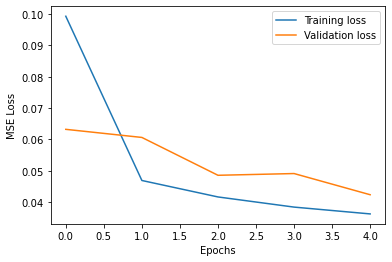

In [15]:
# Show training losses
plt.plot(train_loss, label='Training loss')
plt.plot(val_loss, label='Validation loss')
plt.xlabel('Epochs')
plt.ylabel('MSE Loss')
plt.legend()
plt.show()

del training_ds, validation_ds
torch.cuda.empty_cache()

#### Test 

Define test dataloader, generate predictions and evaluate loss

In [37]:
# Testing data
testing_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_test, out_features=out_features,
                                                  len_sqce=len_sqce, delta_t=delta_t, years=test_years, 
                                                  nodes=nodes, nb_timesteps=nb_timesteps, 
                                                  mean=train_mean_, std=train_std_, 
                                                  max_lead_time=max_lead_time)



Loading data to RAM...
Time: 2.16s


In [38]:
predictions, lead_times, times, nodes, out_lat, out_lon = \
create_iterative_predictions_healpix_temp(spherical_unet, device, testing_ds, constants_tensor.transpose(1,0))

Processing lead time 20 out of 20

Generate predictions ds and save it

In [39]:
das = [];
lev_idx = 0
for var in ['z', 't']:       
    das.append(xr.DataArray(
        predictions[:, :, :, lev_idx],
        dims=['lead_time', 'time', 'node'],
        coords={'lead_time': lead_times, 'time': times[:predictions.shape[1]], 'node': np.arange(nodes)},
        name=var
    ))
    lev_idx += 1

prediction_ds = xr.merge(das)
prediction_ds = prediction_ds.assign_coords({'lat': out_lat, 'lon': out_lon})

In [ ]:
prediction_ds.to_netcdf(pred_filename)

Z500 - 0: 87.45923524281648
T850 - 0: 0.8814564942757158


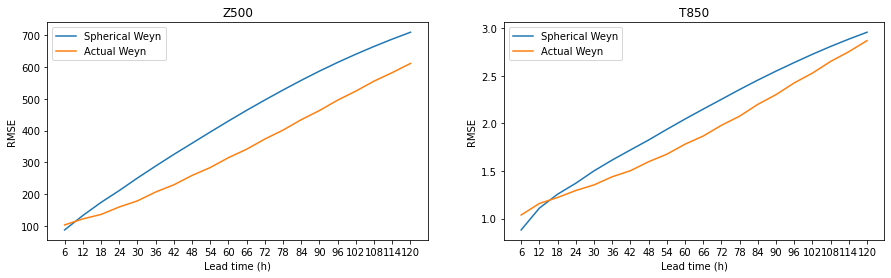

In [41]:
# Compute and save RMSE
rmse = compute_rmse_healpix(prediction_ds, obs).load()
rmse.to_netcdf(rmse_filename)

# Show RMSE
print('Z500 - 0:', rmse.z.values[0])
print('T850 - 0:', rmse.t.values[0])

plot_rmses(rmse, rmses_weyn.rename({'z500':'z', 't850':'t'}).isel(lead_time=list(range(20))), lead_time=6)

#del spherical_unet
del prediction_ds, rmse
torch.cuda.empty_cache()

#### Generate plots for evaluation

In [42]:
resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

obs = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords')
pred = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords')
obs = obs.isel(time=slice(6,pred.time.shape[0]+6))

Compute errors

In [43]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
predc = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords', chunks={'time':chunk_size})
obsc = obsc.isel(time=slice(6,pred.time.shape[0]+6))

In [56]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(predc, obsc)
print(time.time() - t)

time corr_map   325.8087935447693
time rbias_map  82.91916489601135
time rsd_map  120.83545923233032
time rmse map  67.60900902748108
626.6957840919495


Chunked files

In [44]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(predc, obsc)
print(time.time() - t)

loading data
time to load data:  52.69881725311279
time mean obs  25.83211588859558
time mean pred  31.87740159034729
time std obs  73.29803109169006
time std pred  54.553487062454224
time cov  71.94840669631958
time corre_map  0.0050601959228515625
time rbias map  48.12403893470764
time rsd map  0.002230405807495117
time rmse map  46.923449754714966
439.4234495162964


Not chunked files

In [60]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(predc, obsc)
print(time.time() - t)

loading data
time to load data:  61.33081126213074
time mean obs  27.32513928413391
time mean pred  33.59788250923157
time std obs  74.10495328903198
time std pred  71.60137629508972
time cov  59.851123094558716
time corre_map  0.00998544692993164
time rbias map  50.404234647750854
time rsd map  0.0019307136535644531
time rmse map  44.48487448692322
455.62245297431946


In [22]:
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(pred, obs)

In [45]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/' + description + '/'


In [46]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [47]:
rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')
rbias_spherical = rbias_map.mean('node').compute()
rsd_spherical = rsd_map.mean('node').compute()
corr_spherical = corr_map.mean('node').compute()

In [48]:
rbias_spherical.to_netcdf(metrics_path + 'rbias_' + description + '.nc')
rsd_spherical.to_netcdf(metrics_path + 'rsd_' + description + '.nc')
corr_spherical.to_netcdf(metrics_path + 'corr_' + description + '.nc')

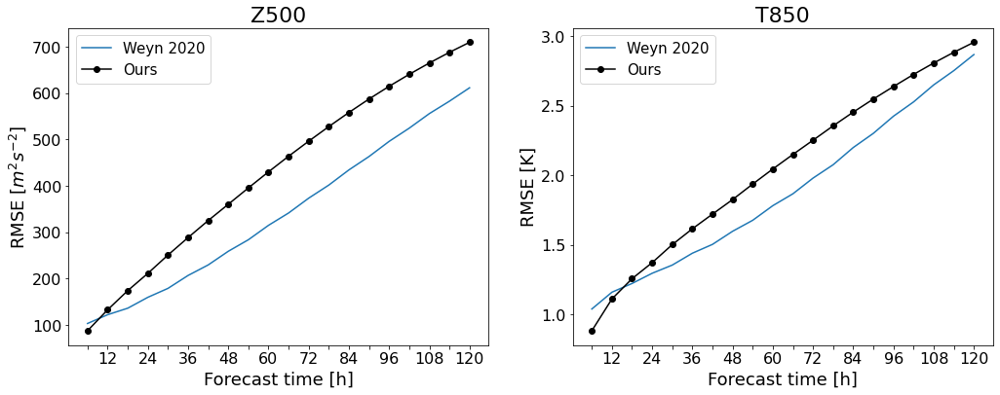

In [49]:
plot_benchmark_simple(rmse_spherical, description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

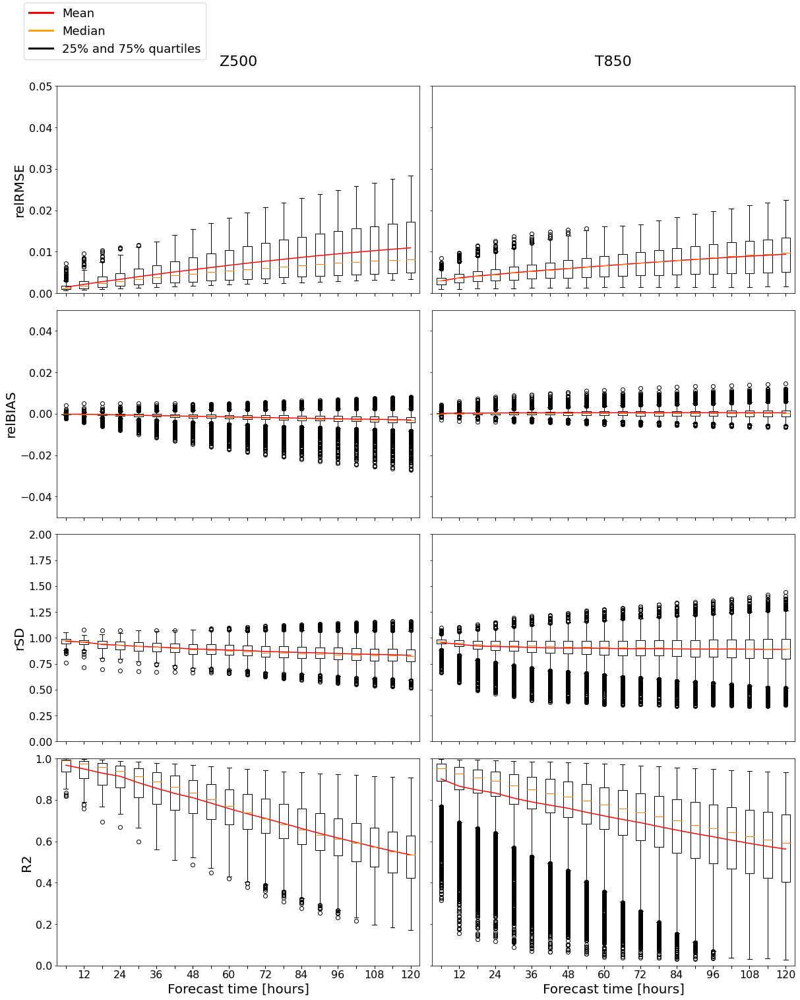

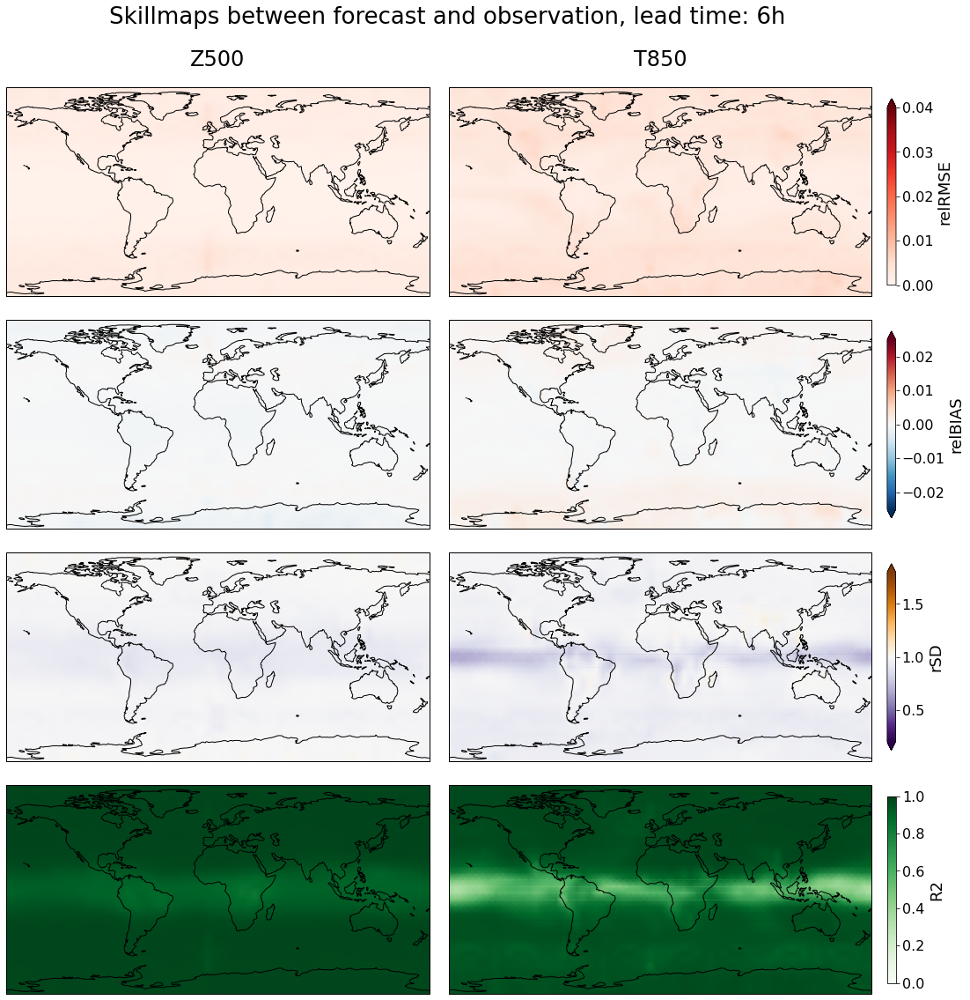

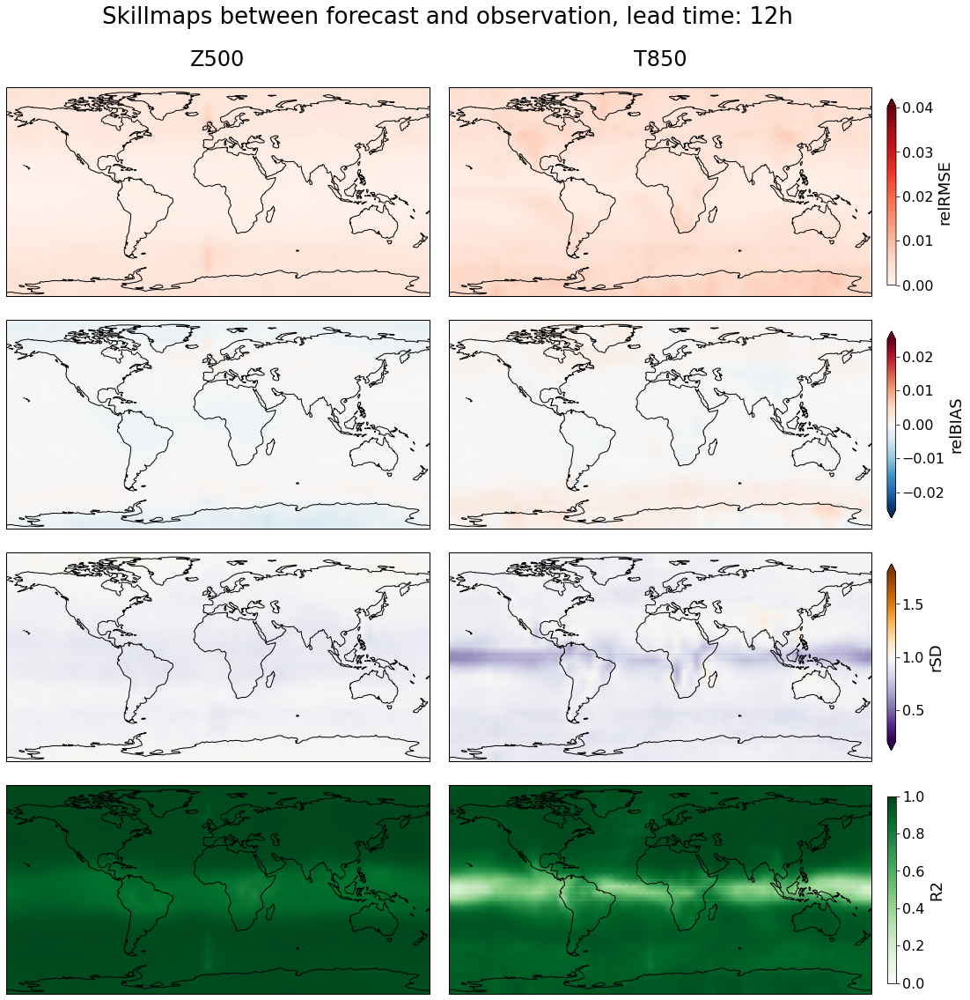

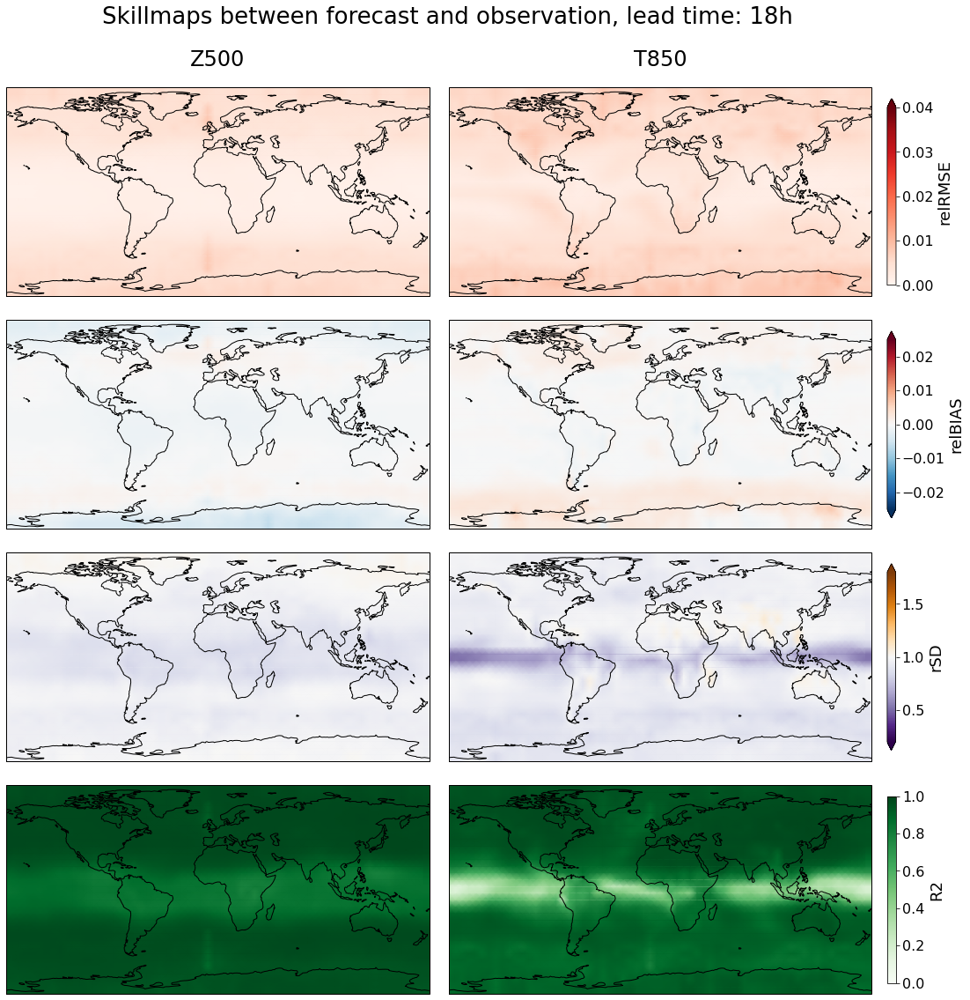

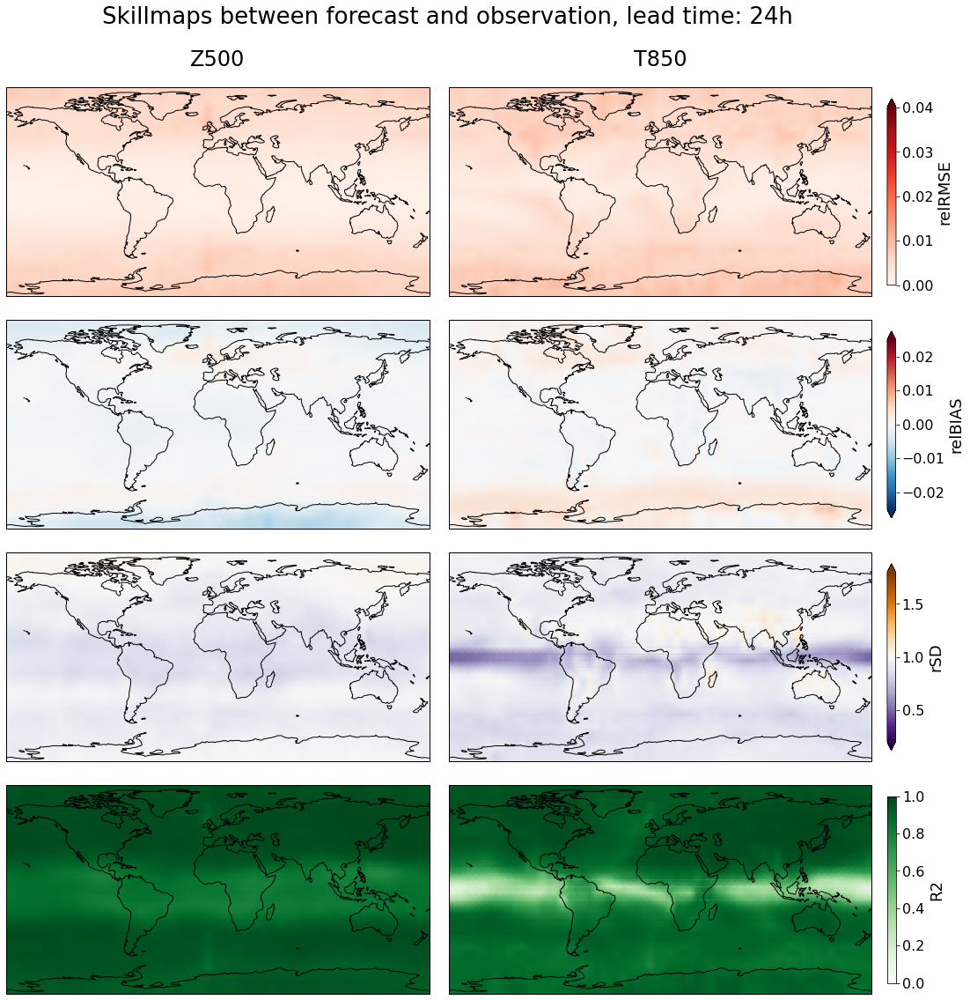

...

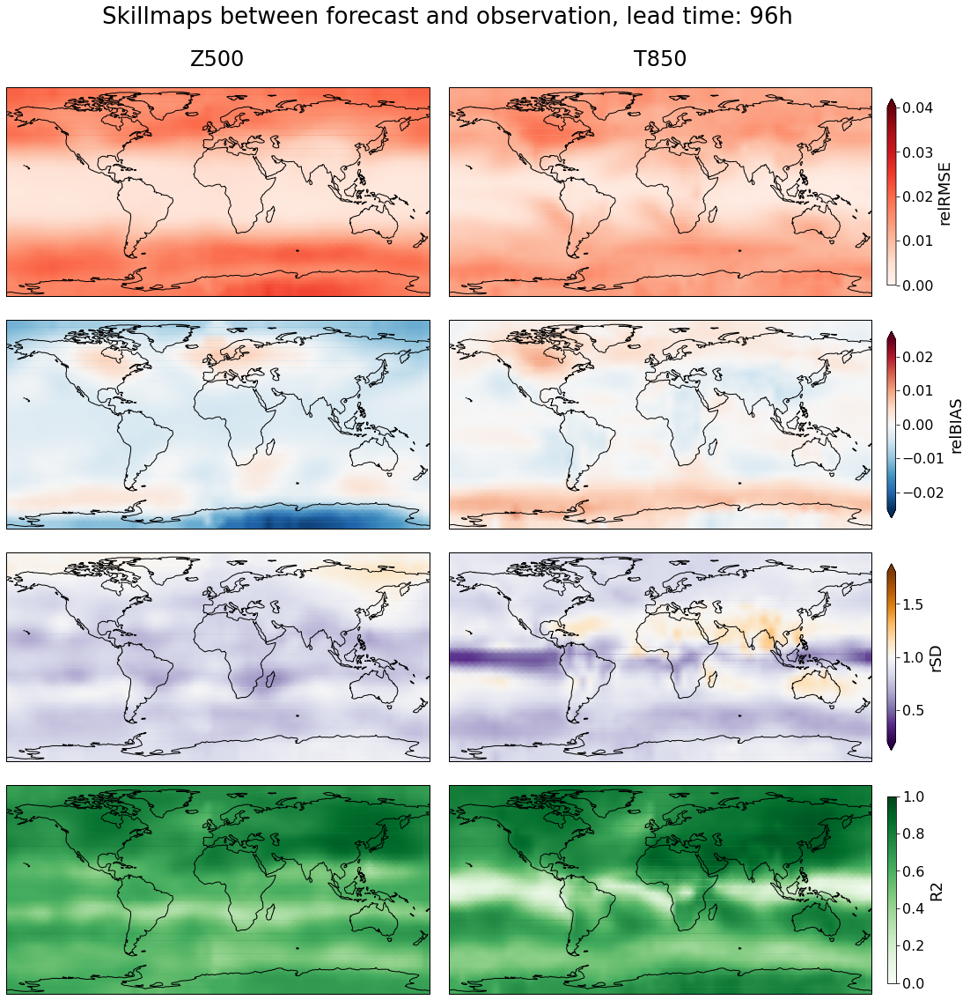

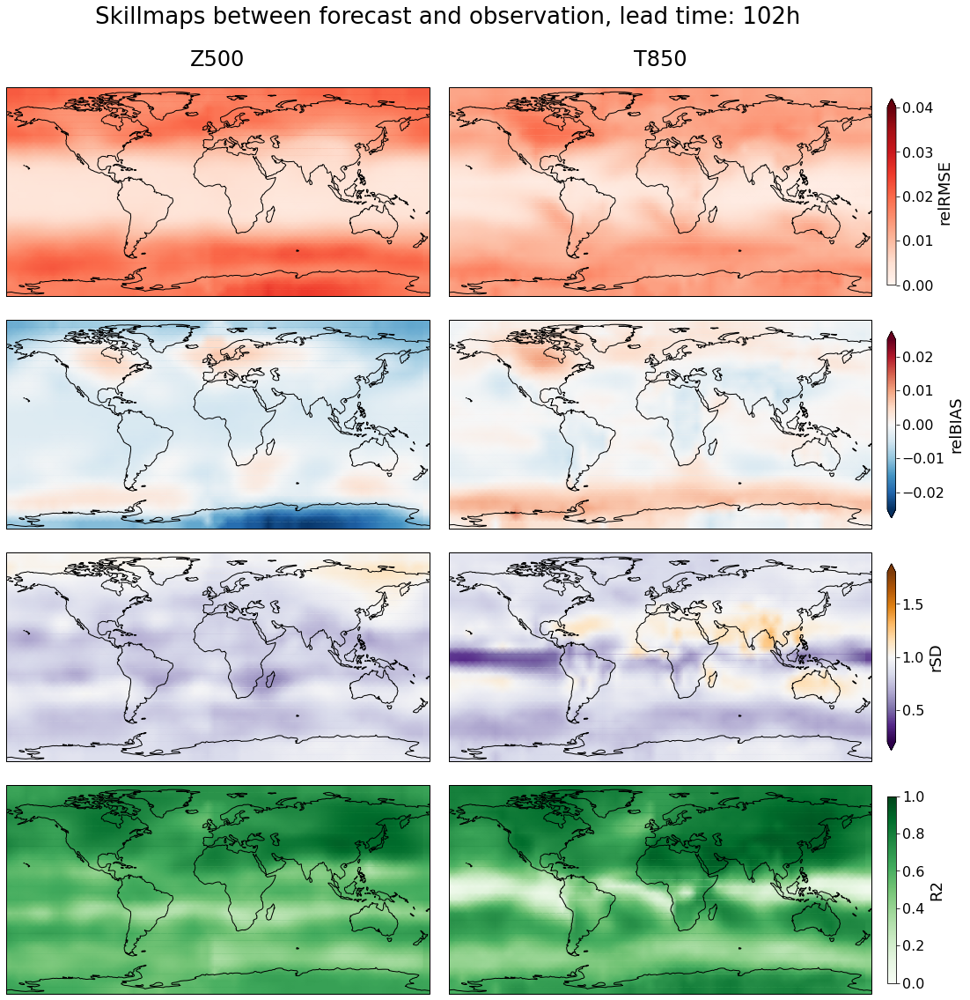

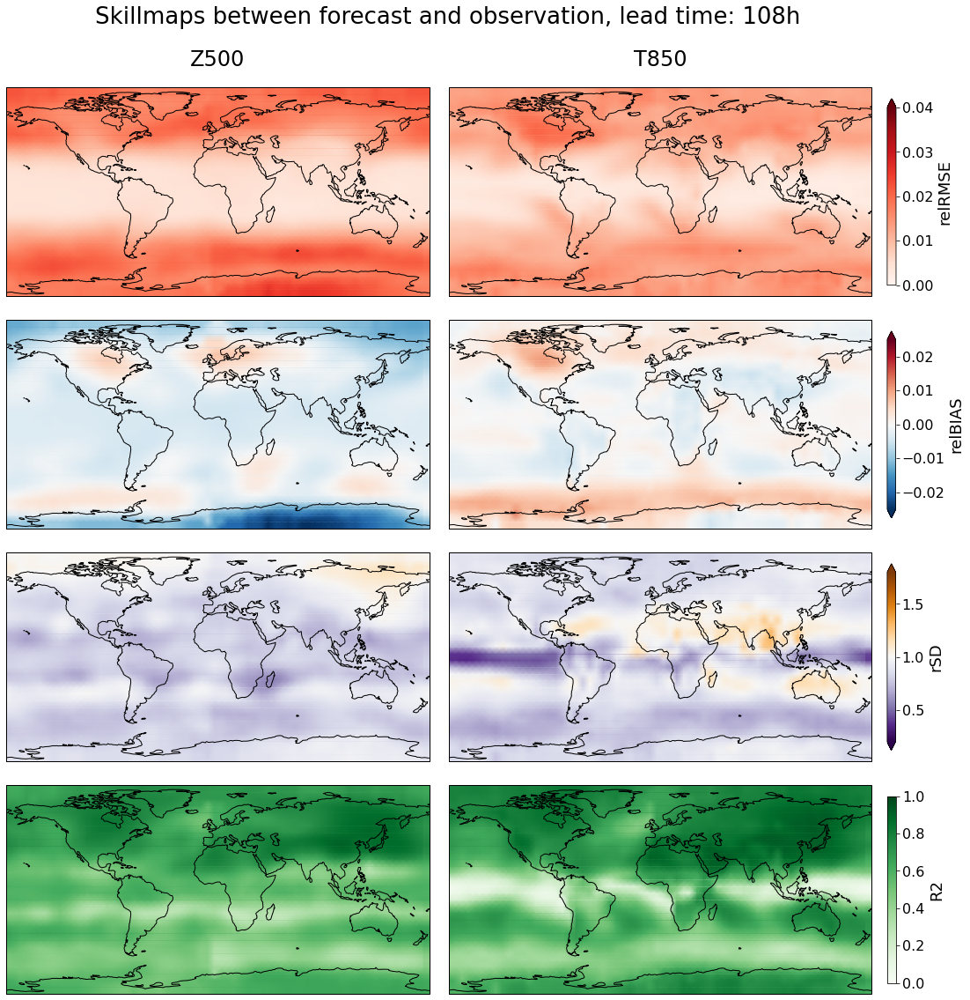

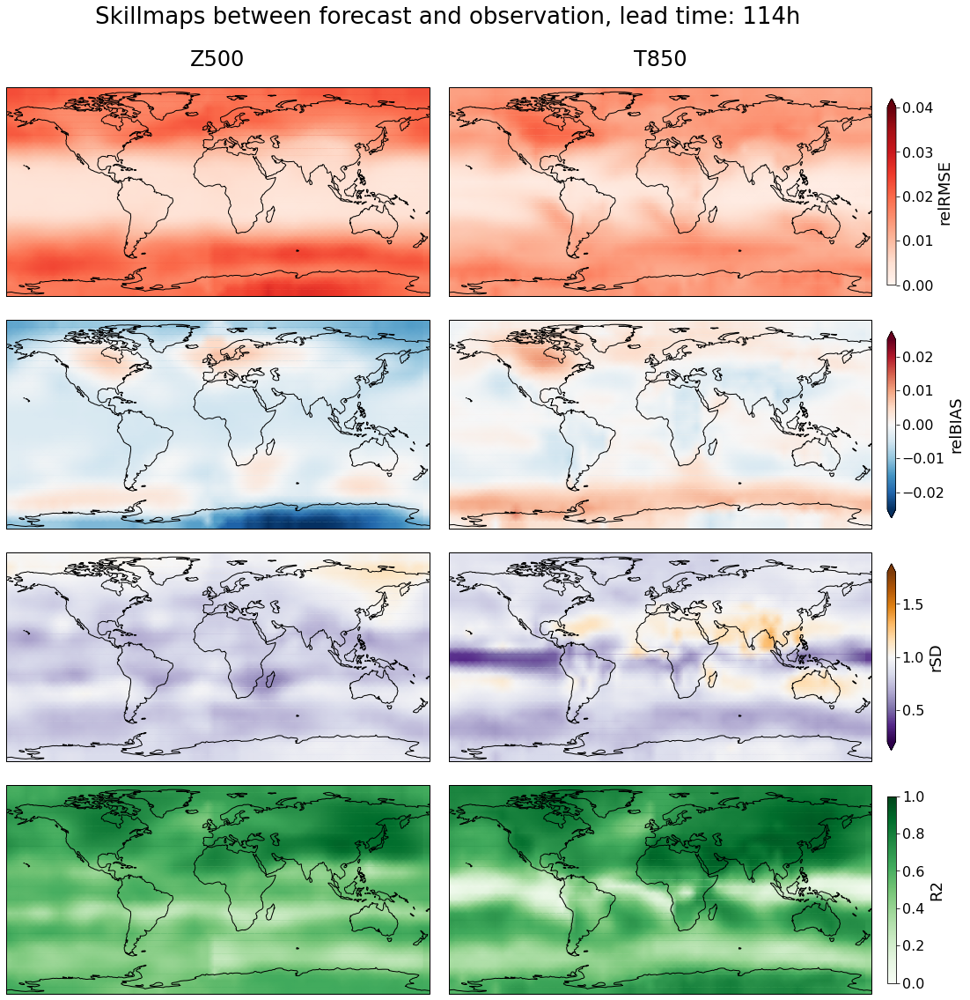

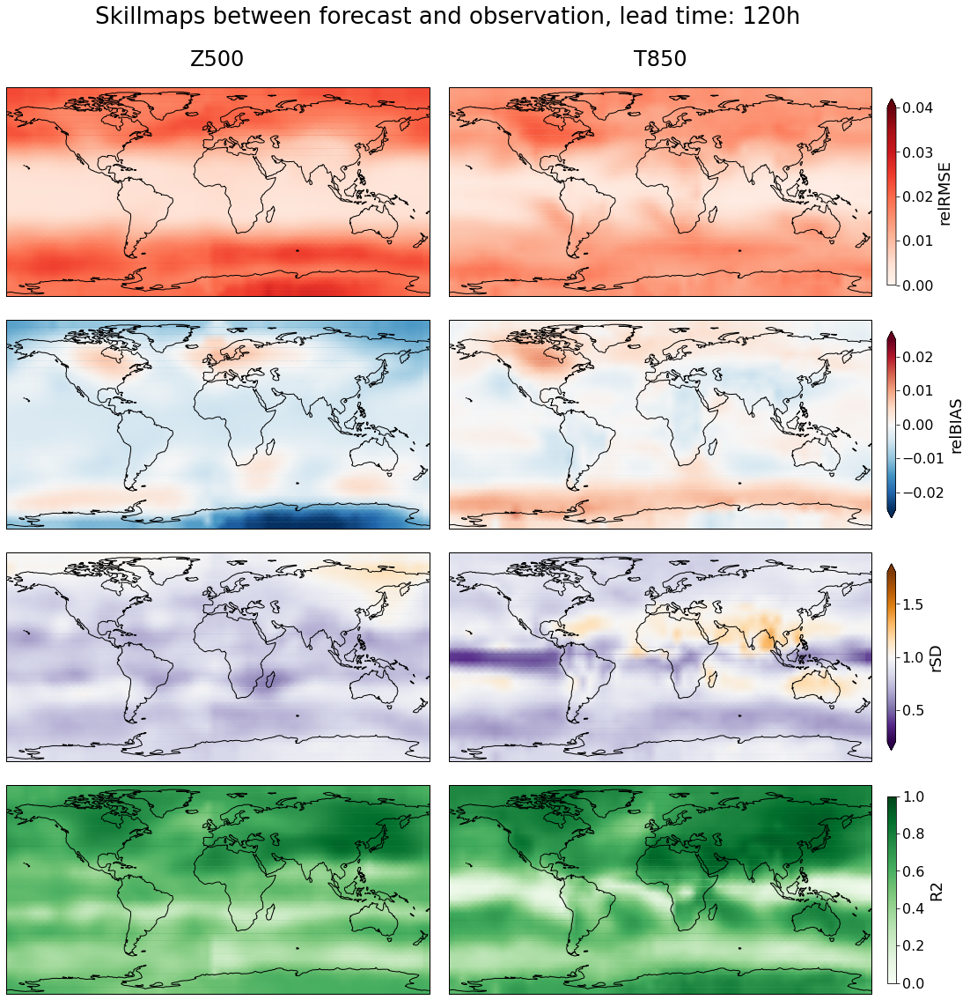

In [50]:
plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, description, lead_times, 
                    output_dir=figures_path, title=False)

plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, description, lead_times, resolution, 
               output_dir=figures_path)

Climatology Hovmoller

In [51]:
monthly_mean = pred.groupby('time.month').mean().compute()
monthly_mean_obs = obs.groupby('time.month').mean().compute()

In [52]:
lead_idx = 19

# Computations
monthly_mean.isel(lead_time=lead_idx)
monthly_mean_eq = []
for month in range(12):
    monthly_mean_eq.append(hp_to_equiangular(monthly_mean.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq = xr.concat(monthly_mean_eq, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq = monthly_mean_eq.mean('lon')

monthly_mean_obs.isel(lead_time=lead_idx)
monthly_mean_eq_obs = []
for month in range(12):
    monthly_mean_eq_obs.append(hp_to_equiangular(monthly_mean_obs.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq_obs = xr.concat(monthly_mean_eq_obs, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq_obs = monthly_mean_eq_obs.mean('lon')

pred_z = np.rot90(monthly_lat_eq.z.values, 3)
pred_t = np.rot90(monthly_lat_eq.t.values, 3)
obs_z = np.rot90(monthly_lat_eq_obs.z.values, 3)
obs_t = np.rot90(monthly_lat_eq_obs.t.values, 3)

diff_z = pred_z / obs_z
diff_t = pred_t / obs_t

# Labels and limits
ticks = np.linspace(0, 31, 7).astype(int)
lat_labels = np.linspace(-90, 90, 7).astype(int)
month_labels = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

vmin_z = min(np.min(monthly_lat_eq.z).values.flatten()[0], np.min(monthly_lat_eq_obs.z).values.flatten()[0])
vmax_z = max(np.max(monthly_lat_eq.z).values.flatten()[0], np.max(monthly_lat_eq_obs.z).values.flatten()[0])
vmin_t = min(np.min(monthly_lat_eq.t).values.flatten()[0], np.min(monthly_lat_eq_obs.t).values.flatten()[0])
vmax_t = max(np.max(monthly_lat_eq.t).values.flatten()[0], np.max(monthly_lat_eq_obs.t).values.flatten()[0])

delta = min((np.min(diff_z)-1), (1-np.max(diff_z)), (np.min(diff_t)-1), (1-np.max(diff_t)))

vmin_sd = 1 - delta
vmax_sd = 1 + delta

In [53]:
predictions_vals = {'pred_z': pred_z, 'pred_t': pred_t,'obs_z': obs_z,'obs_t': obs_t}
val_limits = {'vmin_z':vmin_z, 'vmax_z':vmax_z, 'vmin_t':vmin_t, \
              'vmax_t':vmax_t, 'vmin_sd':vmin_sd, 'vmax_sd':vmax_sd}

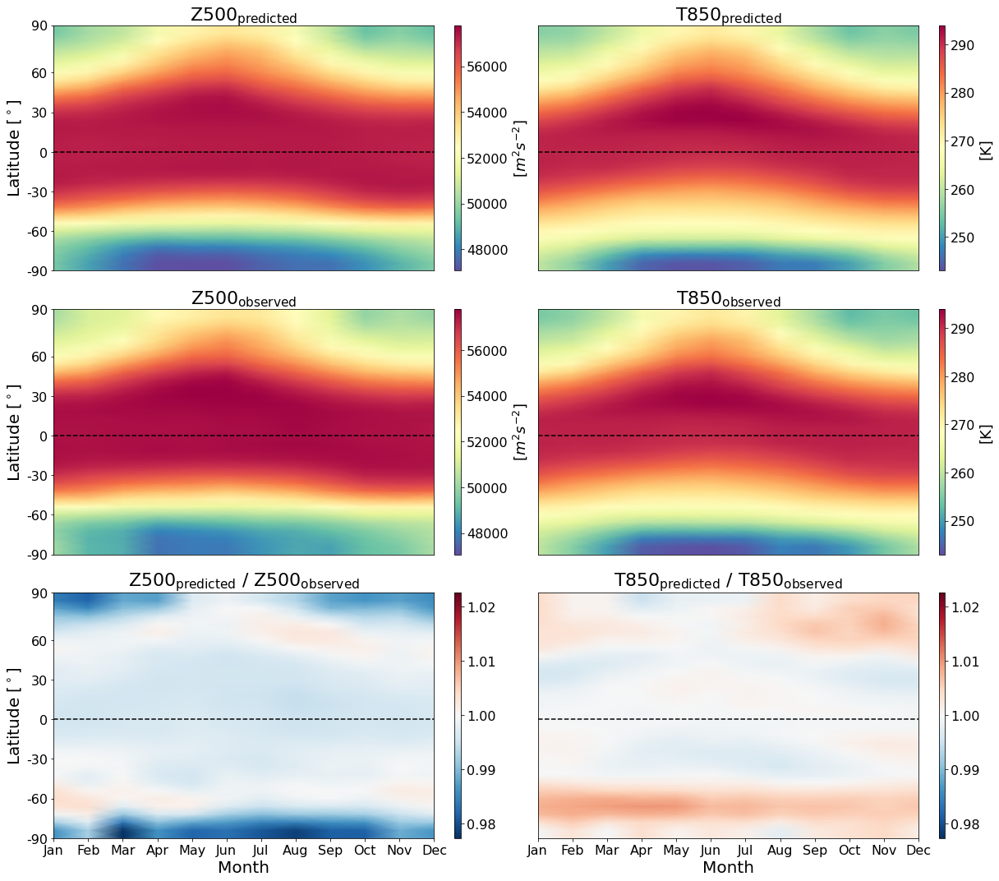

In [54]:
 
figname = figures_path + description + '_hovmoller'
plot_climatology(figname, predictions_vals, val_limits, ticks, lat_labels, month_labels)